These are copied from 4-RPM_tumors-velocity-cellrank.ipynb. They ended up not being used for velocity calculations for the paper.

# RNA Velocity on all tumors -- dynamical velocity + cellrank

## Calculating Velocity

We'll save adata as `adata_original` here so we can reload this version for each version of calculating velocity.

In [4]:
adata_original = adata.copy()

In [5]:
scv.pp.neighbors(adata) # subsetting corrupted neighborhood graph-- redo here
scv.pp.moments(adata)
# scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
# scv.tl.velocity_graph(adata)
scv.tl.recover_dynamics(adata, n_jobs=8) #uses velocity genes from deterministic model as default
scv.tl.velocity(adata, mode="dynamical")
scv.tl.velocity_graph(adata)

computing neighbors
    finished (0:00:13) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:16) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/16 cores)


  0%|          | 0/3415 [00:00<?, ?gene/s]

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/scvelo/tools/dynamical_model.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.alpha, dm.beta, dm.gamma, dm.pars[:3]]) / dm.m[-1]
/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/scvelo/tools/dynamical_model.py:716: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.t, dm.tau, dm.t_, dm.pars[4]]) * dm.m[-1]


    finished (0:22:10) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:57) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/15138 [00:00<?, ?cells/s]

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:03:33) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


saving figure to file figures/scvelo_/full-data/timepoint.png


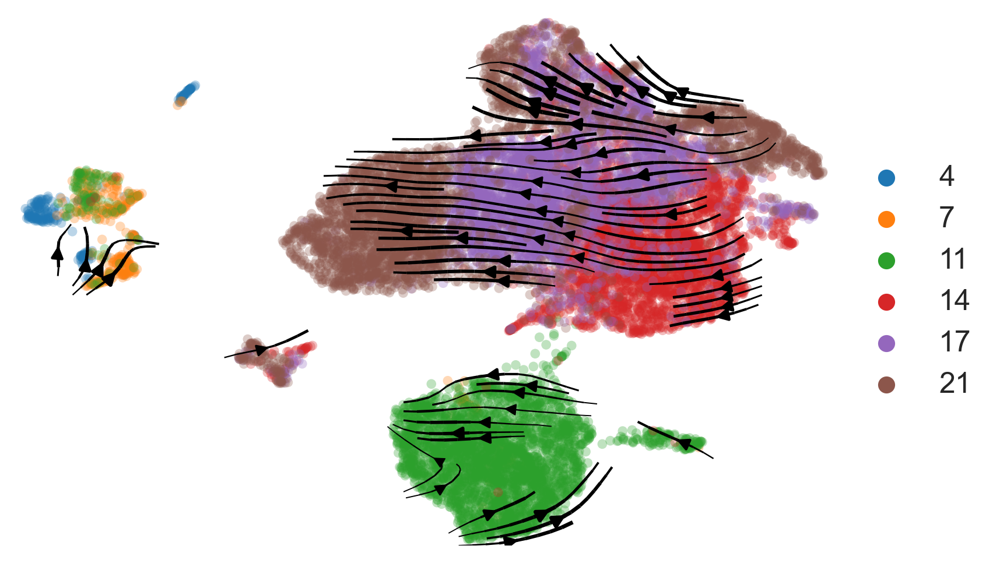

In [7]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_imputed", legend_fontsize=12, title="", smooth=0.8, min_mass=4, color = 'timepoint',
    legend_loc = 'on right', dpi = 300,
    save = 'figures/scvelo_/full-data/timepoint.png'
)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)
saving figure to file figures/scvelo_/full-data/confidence.png


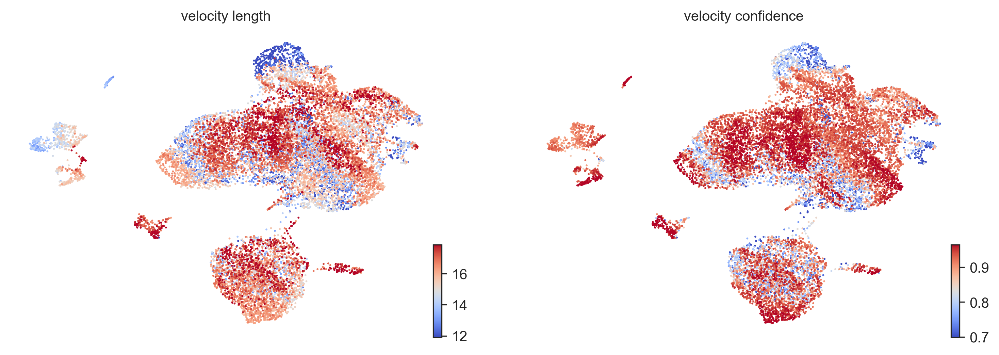

In [8]:
scv.tl.velocity_confidence(adata)

keys = 'velocity_length', 'velocity_confidence'  
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95], basis = 'umap_imputed',
                 dpi = 300, save = 'figures/scvelo_/full-data/confidence.png')



saving figure to file figures/scvelo_/full-data/timepoint_grid.png


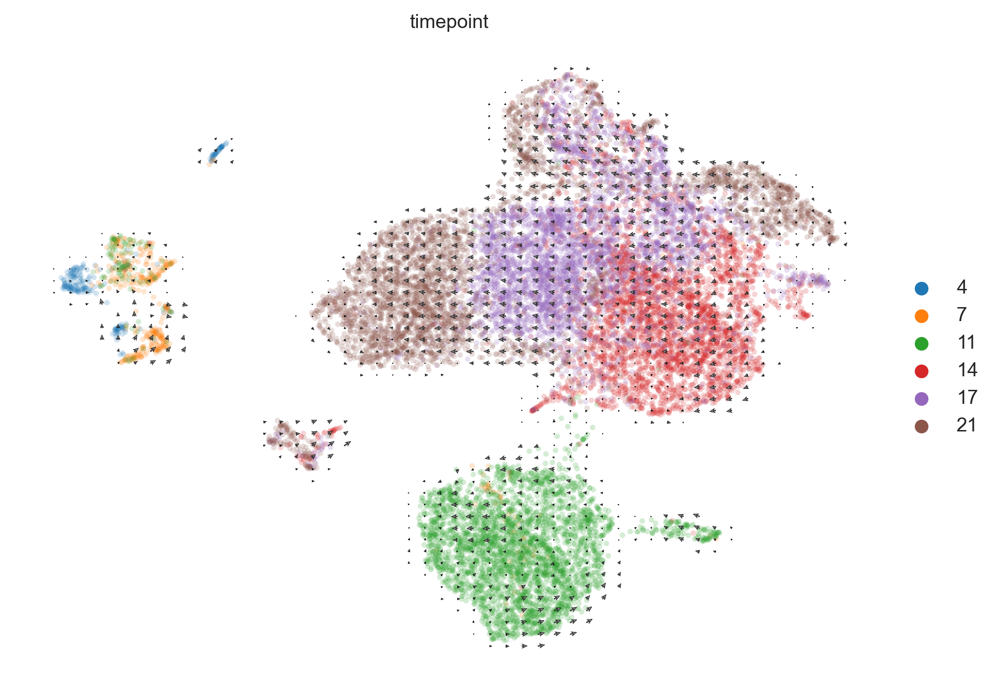

In [9]:
scv.pl.velocity_embedding_grid(adata, vkey='velocity',basis = 'umap_imputed', figsize = (8,6), legend_loc = 'on right',color = 'timepoint',
                              dpi = 300, save = 'figures/scvelo_/full-data/timepoint_grid.png')


Let's save the data at this point.

In [10]:
adata.write_h5ad('../../out/RPM-time-series/adata_04_full.h5ad')



In [15]:
adata = sc.read_h5ad('../../out/RPM-time-series/adata_04_full.h5ad')



## Kinetic Rate Parameters

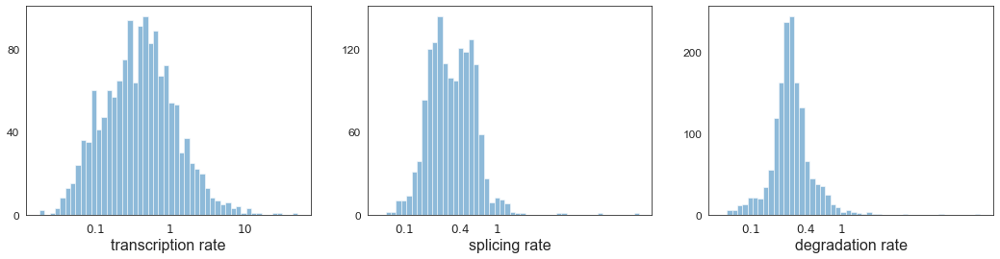

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/scvelo/core/_anndata.py:311: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  df.var_names = df.index


,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
Gene,,,,,,,,,,,,,,,,
Xkr4,0.683899,0.014802,0.004945,0.073303,39.637125,30.772888,0.729309,0.035550,3.215072e-21,0.0,0.0,0.219801,2.384638,0.123024,0.729908,9.857661
Snhg6,0.061348,0.304055,2.753860,0.170196,10.578994,0.133823,0.040115,0.354964,2.191679e-01,0.0,0.0,0.407861,0.122803,1.349608,1.093221,2.891894
Eloc,0.015085,2.264057,7.119534,0.363788,14.092117,0.034842,0.083007,1.125694,2.432976e-01,0.0,0.0,0.472492,0.272550,4.358558,0.871466,1.814109
Gm28154,0.030814,0.050048,4.624821,6.445398,2.177496,1.633795,0.004016,0.001352,1.202069e-04,0.0,0.0,0.000085,0.013709,0.008200,3.577514,0.043817
Rims1,0.364192,0.015643,0.015280,0.070707,20.755263,8.826750,0.277080,0.029194,4.204244e-15,0.0,0.0,0.422568,0.830750,0.127075,2.062038,7.642557


In [11]:
df = adata.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata, 'fit*', dropna=True).head()

## CellRank

saving figure to file figures/scvelo_/full-data/timepoint_arcs_stream.png


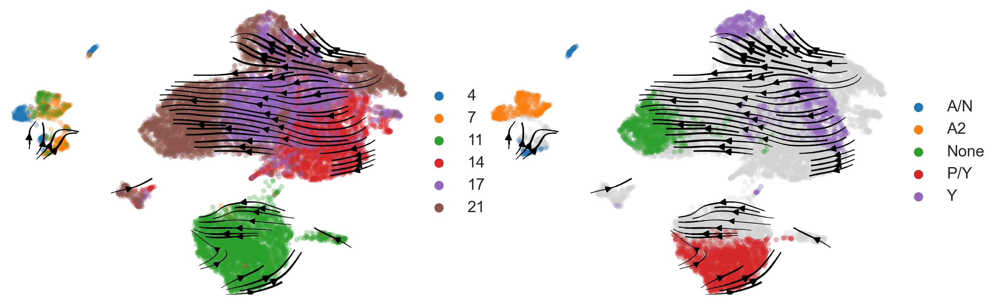

In [19]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_imputed", color = ['timepoint', 'ParetoTI_specialists'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300,
    save = 'figures/scvelo_/full-data/timepoint_arcs_stream.png'
)

saving figure to file figures/scvelo_/full-data/top_gene_fits_leiden.png


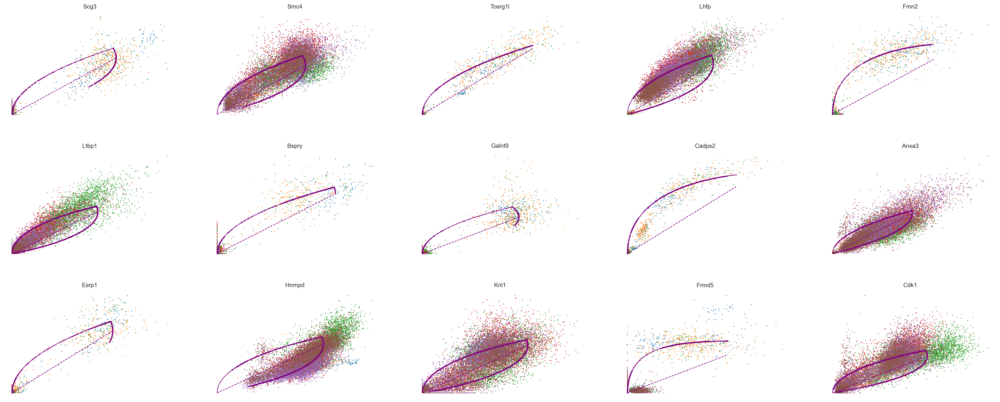

In [40]:
#Fit Genes
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False, color = 'timepoint', save = "figures/scvelo_/full-data/top_gene_fits_leiden.png", dpi = 300)

In [20]:
class MyKernel(cr.tl.kernels.Kernel):
    def __init__(
        self, adata: AnnData, obs_key: str = "Diffusion Pseudotime", **kwargs: Any
    ):
        super().__init__(adata=adata, obs_key=obs_key, **kwargs)

    def _read_from_adata(self, obs_key: str, **kwargs: Any) -> None:
        super()._read_from_adata(**kwargs)

        print(f"Reading `adata.obs[{obs_key!r}]`")
        self.pseudotime = self.adata.obs[obs_key].values

    def compute_transition_matrix(self, some_parameter: float = 0.5) -> "MyKernel":
        print("Accessing `.pseudotime`: ", self.pseudotime)
        transition_matrix = sp.diags(
            (some_parameter,) * len(self.adata), dtype=np.float64
        )

        self._compute_transition_matrix(transition_matrix)

        return self

    def copy(self) -> "MyKernel":
        return copy(self)

In [21]:
k = MyKernel(adata).compute_transition_matrix()
k.compute_transition_matrix()

Reading `adata.obs['Diffusion Pseudotime']`
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]


<MyKernel>

In [22]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/15138 [00:00<?, ?cell/s]

  0%|          | 0/15138 [00:00<?, ?cell/s]

<VelocityKernel>

In [23]:
combined_kernel = 0.8 * vk + 0.2* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(combined_kernel)
g.compute_schur(n_components=20)
print(g)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000075e+00 -3.6798938460636205e-04 2.9751207824711091e-03 6.1223931848644816e-03 -3.1048248898490282e-03 1.9379684755453638e-02 -4.4454622850071762e-02 2.9467922446763602e-02 9.9597335115570694e-03 3.4937969536404621e-02 -2.8678541854750880e-03 -4.8106619469558114e-03 -3.6635900744453193e-02 -1.7822058401360152e-02 4.4177344732653423e-03 2.9695200201944123e-03 7.9184360159678391e-03 2.8345065960322824e-02 -2.5466933797333009e-02 1.0206726978241742e-02 -4.4290916965292054e-02 
0.0000000000000000e+00 9.9659705555622080e-01 -9.7745040655598651e-04 -5.2348809893639360e-04 -1.2990945637826344e-02 -7.0444707602800158e-03 7.4413850346243347e-03 -6.3970709109149437e-03 -3.3314809836710643e-03 -1.4772695280299708e-04 -4.7130002360642062e-02 9.8896097000358385e-04 6.4445372038531359e-03 3.1748005958655971e-03 -1.2280470848038787e-03 -8.5608950212518787e-04 -5.5072675989096875e-02 5.3827734094543764e-02 7.8521475613697062e-03 -1.60123045887

## Macrostates: timepoints

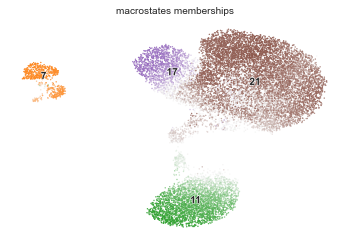

  0%|          | 0/4 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket


In [45]:
g.compute_macrostates(cluster_key="timepoint") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

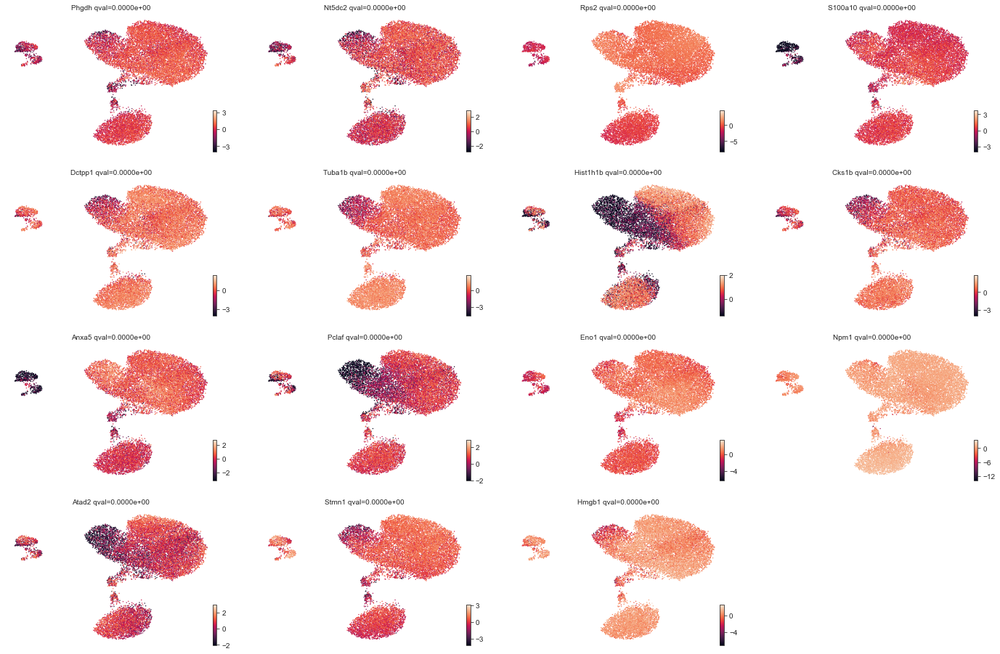

In [26]:
dayterm_drivers = g.compute_lineage_drivers(lineages="21", return_drivers=True) #when running macrostates and terminal states by archetype
dayterm_drivers.sort_values(by="21_corr", ascending=False)
g.plot_lineage_drivers("21", n_genes=15)

In [27]:
scv.tl.paga(
    adata,
    groups="timepoint",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="Diffusion Pseudotime",
)

running PAGA using priors: ['Diffusion Pseudotime', 'terminal_states_probs']
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


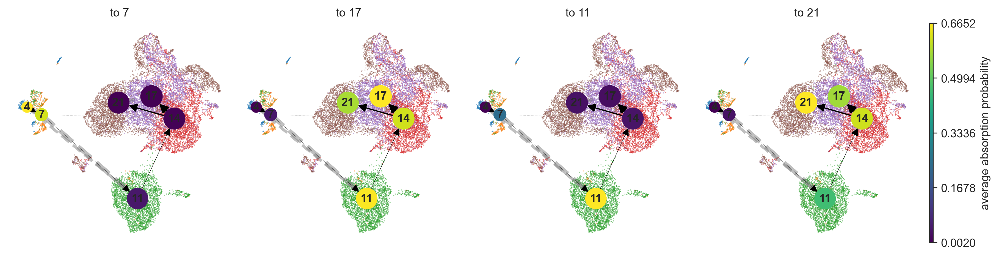

In [47]:
cr.pl.cluster_fates(
    adata,
    mode="paga",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300, save = './figures/scvelo_/full-data/paga_timepoint.png')

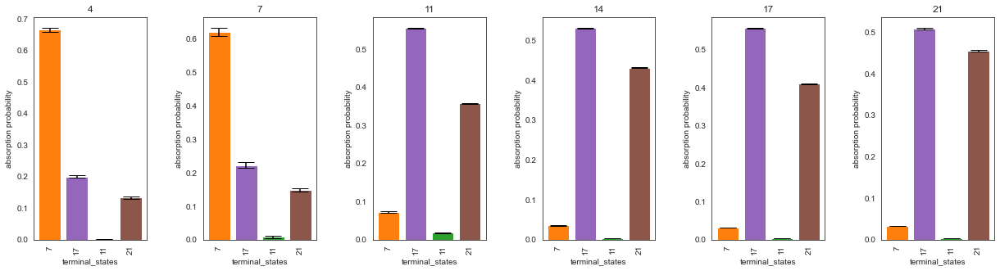

In [49]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed", ncols = 6, save = './figures/scvelo_/full-data/paga_bar_timepoint.pdf')


## Macrostates: subtypes

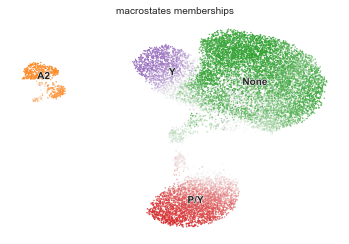

  0%|          | 0/4 [00:00<?, ?/s]

In [51]:
g.compute_macrostates(cluster_key="ParetoTI_specialists") #to change macrostates calcualted by archetype
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

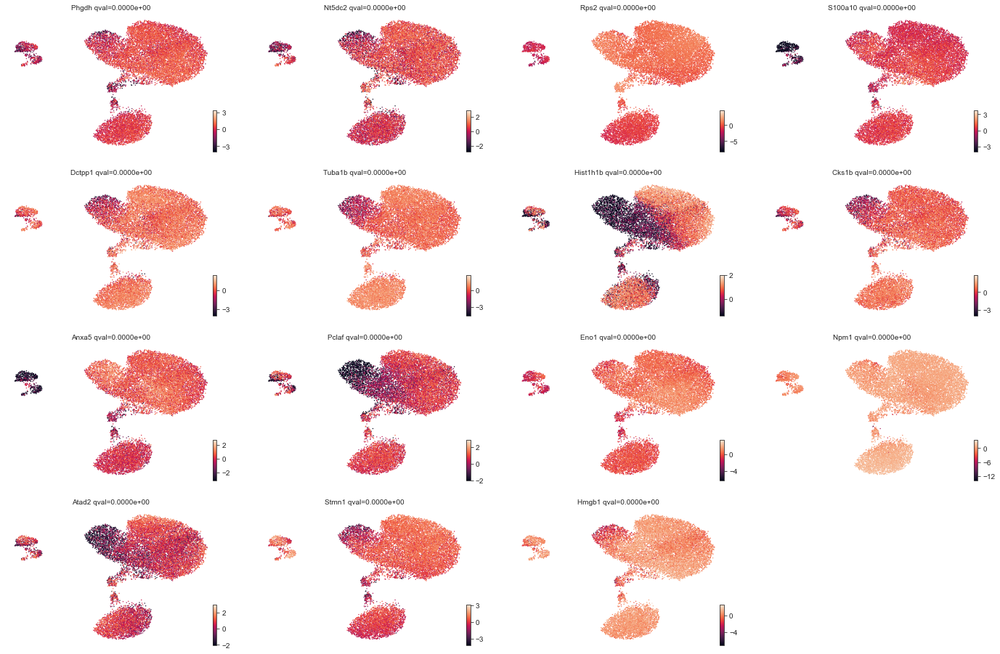

In [35]:
day21_drivers = g.compute_lineage_drivers(lineages="None", return_drivers=True)  #when running macrostates and terminal states by timepoint
day21_drivers.sort_values(by="None_corr", ascending=False)
g.plot_lineage_drivers("None", n_genes=15)

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


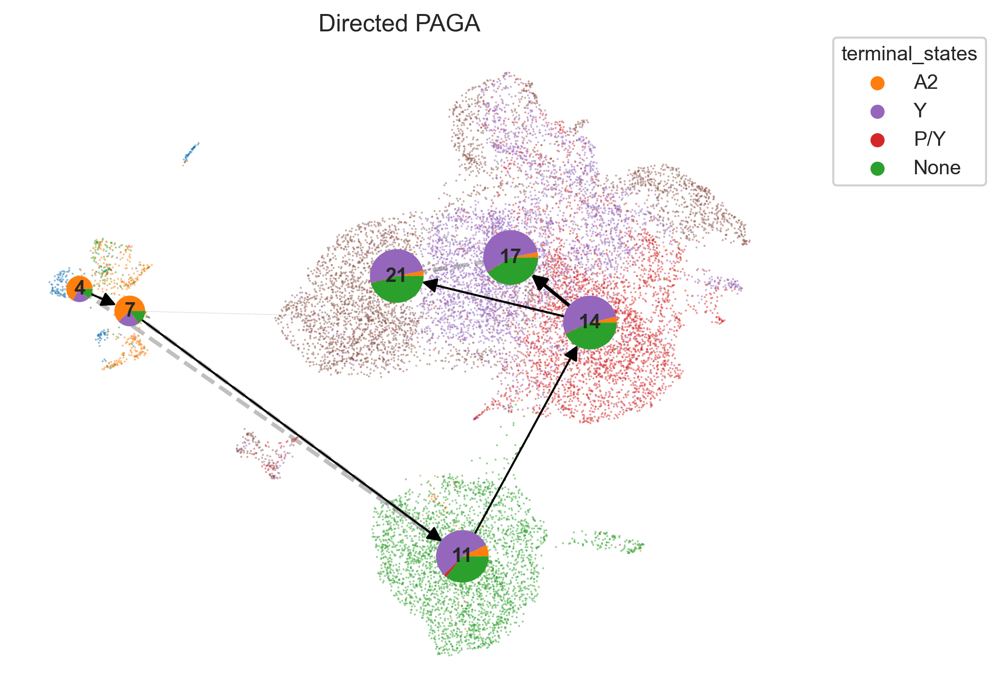

In [53]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=4,
    edge_width_scale=1,
    min_edge_width=1,
    dpi = 300,
    title="Directed PAGA",figsize = (6, 5), save = './figures/scvelo_/full-data/paga_subtype.png')

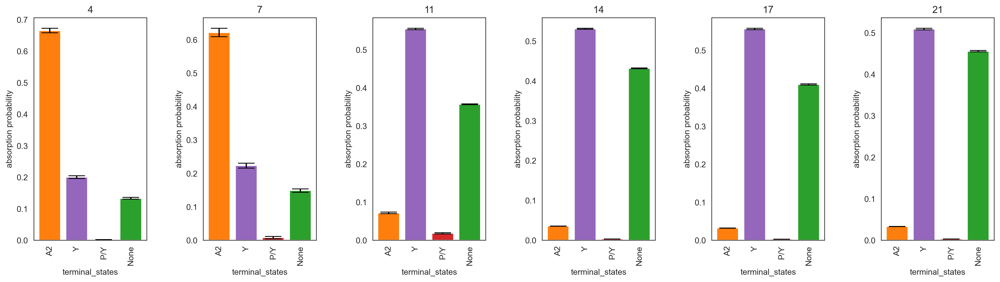

In [55]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed",ncols = 6, save = 'paga_bar_subtype.png', dpi = 300)


In [60]:
adata.uns['coarse_fwd'] = None #there isn't an implementation to write to h5ad with an anndata object in attributes of another anndata

In [61]:
adata.write_h5ad('../../out/RPM-time-series/adata_04_full.h5ad')


In [62]:
adata

AnnData object with n_obs × n_vars = 15138 × 19455
    obs: 'Diffusion Pseudotime', 'Monocle Pseudotime', 'Clusters', '_X', '_Y', 'batch', 'doublet_scores', 'predicted_doublets', 'timepoint', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'barcode', 'ireland_barcode', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'specialists_pca_diffdist', 'SCLC-Y_Score', 'SCLC-P_Score', 'SCLC-N_Score', 'SCLC-A2_Score', 'SCLC-A_Score', 'Phenotype', 'SCLC-A_Score_pos', 'SCLC-A2_Score_pos', 'SCLC-N_Score_pos', 'SCLC-P_Score_pos', 'SCLC-Y_Score_pos', 'arc_pheno', 'arc_aa_type', 'ParetoTI_specialists', 'subtype', 'subtype_labeled', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'terminal_states', 'terminal_states_probs'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'mean', 'std', 'n_cells', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma'

Conclusions: With kernel weights set to .8/.2 or .35/.65, the absorbing states and probabiltiies remain the same. So we'll stick with .8/.2, since that's what CellRank does in the tutorial. 

There are 4 endpoints, which is fine, including A2, P/Y (only a little) and Y and None.

The gene plots don't look that good, probably because they need to done independently.

# Differential kinetics

In [63]:
adata = adata_original.copy()

In [65]:
scv.pp.neighbors(adata) # subsetting corrupted neighborhood graph-- redo here
scv.pp.moments(adata)
# scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
# scv.tl.velocity_graph(adata)
scv.tl.recover_dynamics(adata, n_jobs=8) #uses velocity genes from deterministic model as default
scv.tl.differential_kinetic_test(adata,groupby='timepoint')


computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:18) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/16 cores)


  0%|          | 0/3415 [00:00<?, ?gene/s]

    finished (0:32:28) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:20:44) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


In [66]:
scv.get_df(adata, ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)


,fit_diff_kinetics,fit_pval_kinetics
Gene,,
Snhg6,7,2.56e-31
Eloc,17,7.55e-03
Rims1,11,8.66e-04
Ogfrl1,"7,11",9.43e-08
Bag2,11,7.88e-12
...,...,...
Pak3,4,0.00e+00
Acot9,"14,17,21",4.99e-03
Map7d2,4,0.00e+00


## Calculate velocity with diff_kinetics = True

In [67]:
scv.tl.velocity(adata, diff_kinetics=True)
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:00:48) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/15138 [00:00<?, ?cells/s]

    finished (0:06:41) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:04) --> added
    'velocity_umap_imputed', embedded velocity vectors (adata.obsm)
saving figure to file figures/scvelo_/full-data-diffkinetics/timepoint_arcs_stream.png


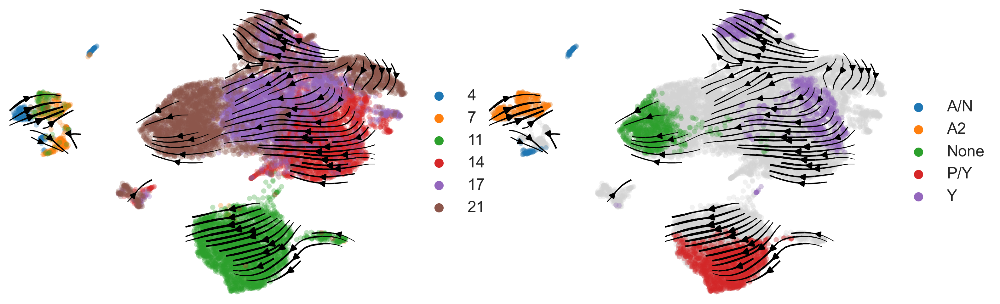

In [68]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_imputed", color = ['timepoint', 'ParetoTI_specialists'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300,
    save = 'figures/scvelo_/full-data-diffkinetics/timepoint_arcs_stream.png'
)

saving figure to file figures/scvelo_/full-data-diffkinetics/top_gene_fits_leiden.png


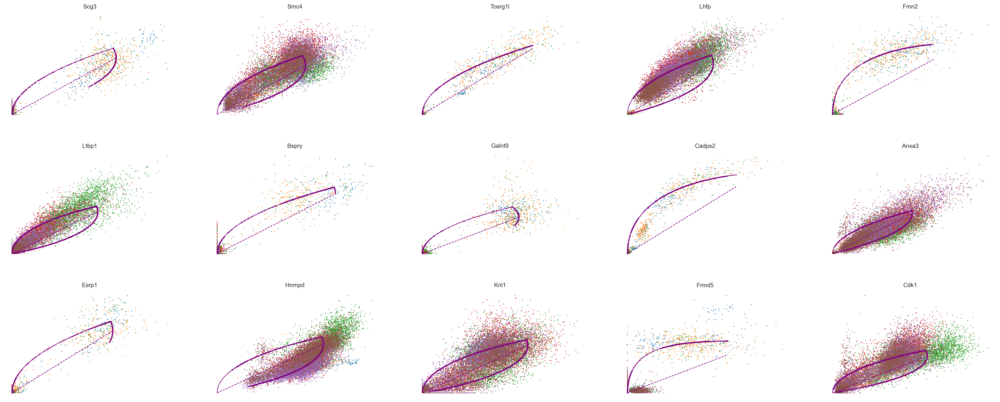

In [69]:
#Fit Genes
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False, color = 'timepoint', save = "figures/scvelo_/full-data-diffkinetics/top_gene_fits_leiden.png", dpi = 300)

In [70]:
class MyKernel(cr.tl.kernels.Kernel):
    def __init__(
        self, adata: AnnData, obs_key: str = "Diffusion Pseudotime", **kwargs: Any
    ):
        super().__init__(adata=adata, obs_key=obs_key, **kwargs)

    def _read_from_adata(self, obs_key: str, **kwargs: Any) -> None:
        super()._read_from_adata(**kwargs)

        print(f"Reading `adata.obs[{obs_key!r}]`")
        self.pseudotime = self.adata.obs[obs_key].values

    def compute_transition_matrix(self, some_parameter: float = 0.5) -> "MyKernel":
        print("Accessing `.pseudotime`: ", self.pseudotime)
        transition_matrix = sp.diags(
            (some_parameter,) * len(self.adata), dtype=np.float64
        )

        self._compute_transition_matrix(transition_matrix)

        return self

    def copy(self) -> "MyKernel":
        return copy(self)

In [71]:
k = MyKernel(adata).compute_transition_matrix()
k.compute_transition_matrix()

Reading `adata.obs['Diffusion Pseudotime']`
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]


<MyKernel>

In [72]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/15138 [00:00<?, ?cell/s]

  0%|          | 0/15138 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket


<VelocityKernel>

In [73]:
combined_kernel = 0.8 * vk + 0.2* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(combined_kernel)
g.compute_schur(n_components=20)
print(g)

Mat Object: 1 MPI processes
  type: seqdense
9.9999999999999611e-01 -2.4985688544047952e-04 -2.2503371670195404e-03 -6.6961737526855880e-04 3.3423857458088181e-03 -5.6132180985646318e-03 1.5291653317974370e-03 6.0624249520786853e-03 -1.2874485987119176e-02 5.4989011000339443e-03 -9.5269465475013044e-03 -2.3073386472684410e-02 -1.0408135506995890e-03 -3.5377061770842932e-02 6.1851889218001114e-03 5.0305242737421665e-02 1.9183702483592139e-02 -4.0635294058120330e-02 -1.4435166927404409e-02 -2.8998639947852595e-02 -2.2785880053768404e-02 -1.0461145744886205e-02 1.2872300420179564e-02 
0.0000000000000000e+00 9.9969772882080776e-01 -1.1054086937196142e-04 3.9153938981515597e-03 7.8372039044402478e-04 -1.3982151987298344e-03 -5.9913831757087074e-03 1.7910975241640364e-03 -3.2562978578216557e-03 1.0535884093304201e-03 -2.3829203089202186e-03 -3.2614469752707178e-03 2.3980051365685072e-04 -8.4807559472434586e-03 2.2992741104561655e-03 1.1315626263435952e-02 3.7885006396650312e-03 -8.8676690146

## Macrostates: timepoints

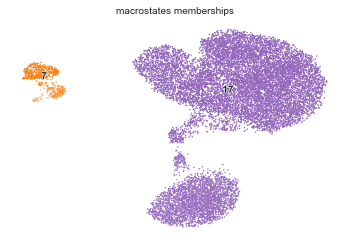

  0%|          | 0/2 [00:00<?, ?/s]

In [74]:
g.compute_macrostates(cluster_key="timepoint") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

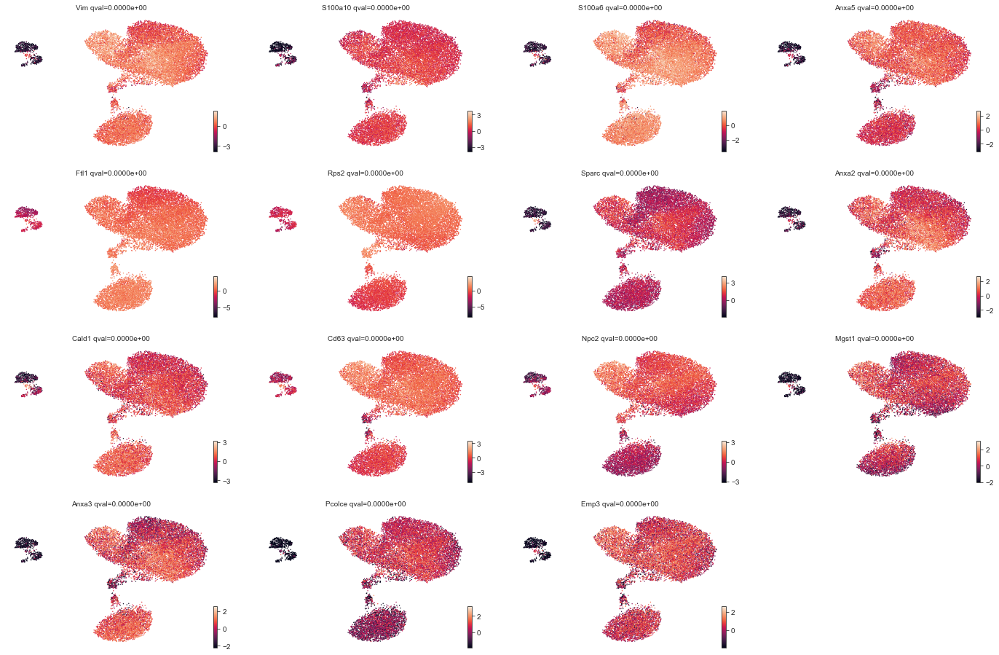

In [76]:
dayterm_drivers = g.compute_lineage_drivers(lineages="17", return_drivers=True) #when running macrostates and terminal states by archetype
dayterm_drivers.sort_values(by="17_corr", ascending=False)
g.plot_lineage_drivers("17", n_genes=15)

In [77]:
scv.tl.paga(
    adata,
    groups="timepoint",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="Diffusion Pseudotime",
)

running PAGA using priors: ['Diffusion Pseudotime', 'terminal_states_probs']
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


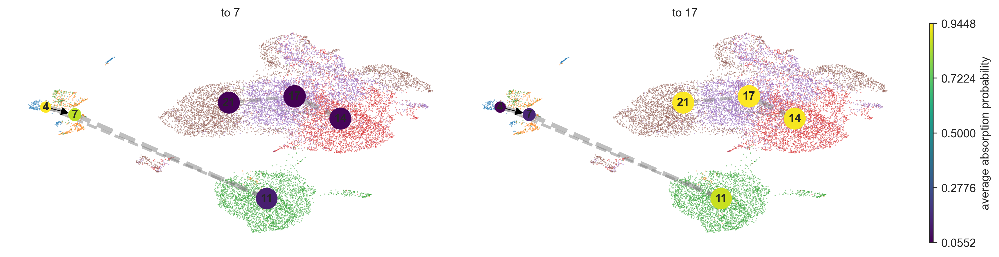

In [78]:
cr.pl.cluster_fates(
    adata,
    mode="paga",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300, save = './figures/scvelo_/full-data-diffkinetics/paga_timepoint.png')

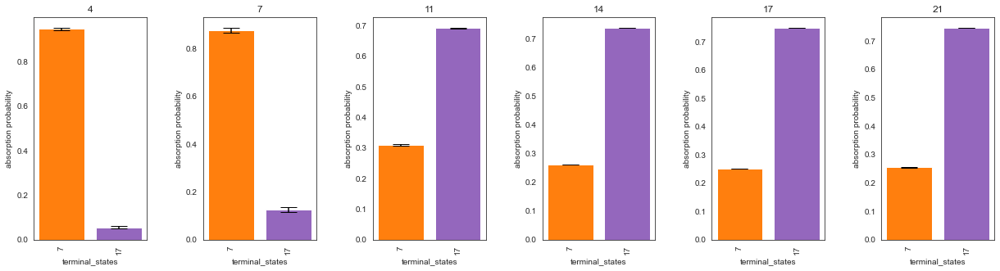

In [79]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed", ncols = 6, save = './figures/scvelo_/full-data-diffkinetics/paga_bar_timepoint.pdf')


## Macrostates: subtypes

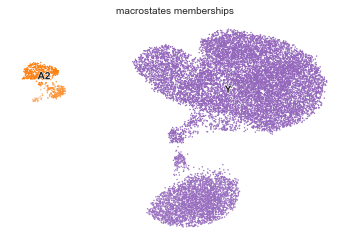

  0%|          | 0/2 [00:00<?, ?/s]

In [80]:
g.compute_macrostates(cluster_key="ParetoTI_specialists") #to change macrostates calcualted by archetype
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

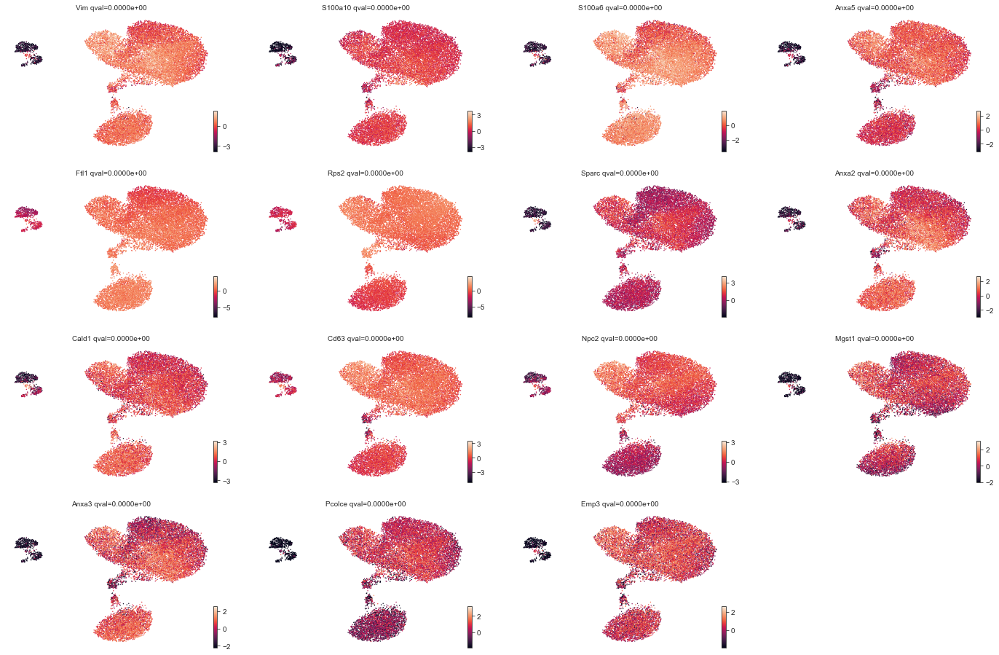

In [82]:
day21_drivers = g.compute_lineage_drivers(lineages="Y", return_drivers=True)  #when running macrostates and terminal states by timepoint
day21_drivers.sort_values(by="Y_corr", ascending=False)
g.plot_lineage_drivers("Y", n_genes=15)

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


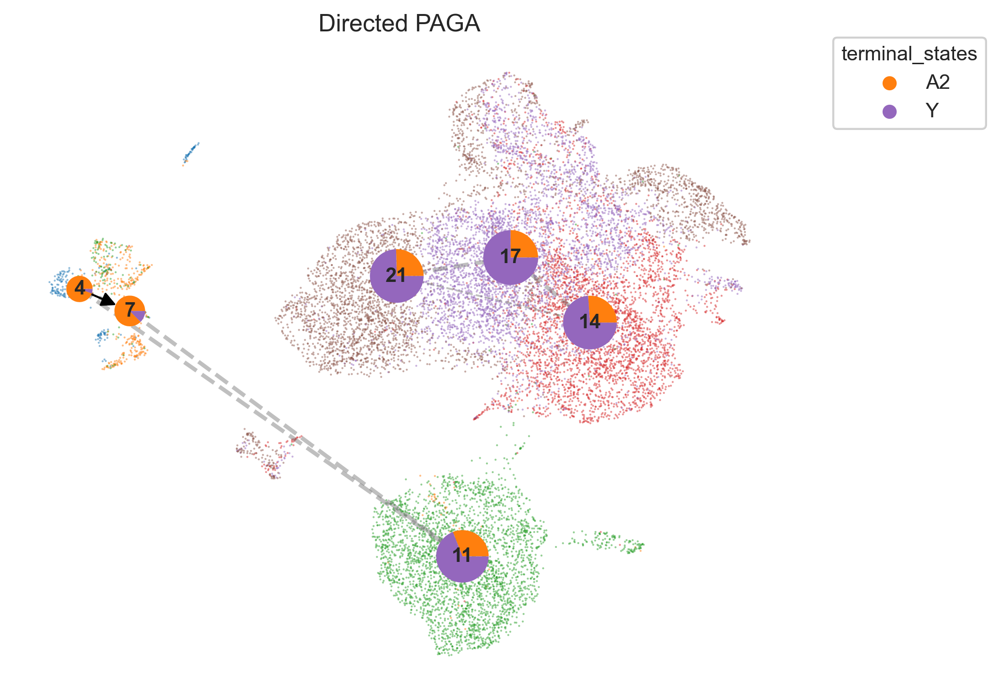

In [83]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=4,
    edge_width_scale=1,
    min_edge_width=1,
    dpi = 300,
    title="Directed PAGA",figsize = (6, 5), save = './figures/scvelo_/full-data-diffkinetics/paga_subtype.png')

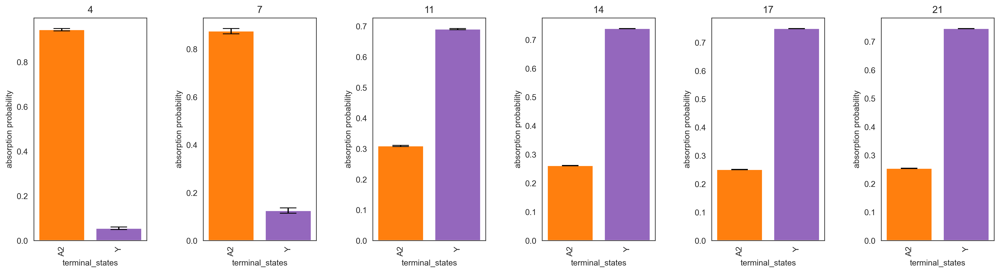

In [84]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed",ncols = 6, save = './figures/scvelo_/full-data-diffkinetics/paga_bar_subtype.png', dpi = 300)


In [85]:
adata.uns['coarse_fwd'] = None #there isn't an implementation to write to h5ad with an anndata object in attributes of another anndata

In [86]:
adata.write_h5ad('../../out/RPM-time-series/adata_04_full-diffkinetics.h5ad')


In [87]:
adata

AnnData object with n_obs × n_vars = 15138 × 19455
    obs: 'Diffusion Pseudotime', 'Monocle Pseudotime', 'Clusters', '_X', '_Y', 'batch', 'doublet_scores', 'predicted_doublets', 'timepoint', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'barcode', 'ireland_barcode', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'specialists_pca_diffdist', 'SCLC-Y_Score', 'SCLC-P_Score', 'SCLC-N_Score', 'SCLC-A2_Score', 'SCLC-A_Score', 'Phenotype', 'SCLC-A_Score_pos', 'SCLC-A2_Score_pos', 'SCLC-N_Score_pos', 'SCLC-P_Score_pos', 'SCLC-Y_Score_pos', 'arc_pheno', 'arc_aa_type', 'ParetoTI_specialists', 'subtype', 'subtype_labeled', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'mean', 'std', 'n_cells', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_

# RNA Velocity on each tumor independently

## RNA velocity and recover dynamics independently

I think our best bet is to just split up the adata object by cell line and run each individually. It would be nice to visualize all together, but some of the functions do not have a `groupby` parameter, and I'm worried calculating something like latent time across samples would infer latent time incorrectly.

In [89]:
import warnings

warnings.simplefilter("ignore", category=DeprecationWarning)

def rna_velocity_recipe(adata, copy = False, basis = 'pca_imputed', resolution = .5, save = False):
    a = adata.copy() if copy else adata

    scv.pp.neighbors(a) # subsetting results in corrupted neighborhood graph-- redo here
    sc.tl.leiden(a, random_state = 0, resolution = resolution)         
            
    scv.pp.moments(a)
    # scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
    # scv.tl.velocity_graph(adata)
    
    ## Recover dynamics
    #see case 2 in https://github.com/theislab/scvelo/issues/497
    if 'velocity_genes' in a.var.columns:
        a.var.drop('velocity_genes',axis=1,inplace=True)

    scv.tl.recover_dynamics(a, n_jobs=8) #uses velocity genes from steady state model as default, but does not add them as attribute!
    scv.tl.velocity(a, mode="dynamical") #now this adds velocity_genes attribute to a
    scv.tl.velocity_graph(a)
    
    ## Plot embedding stream
    scv.pl.velocity_embedding_stream(a, basis=basis, legend_fontsize=12, title="", smooth=0.8, min_mass=4, color = 'leiden', save="velocity_embedding_stream_"+save)
    
    ## Velocity confidence
    scv.tl.velocity_confidence(a)
    keys = 'velocity_length', 'velocity_confidence'  
    scv.pl.scatter(a, c=keys, cmap='coolwarm', perc=[5, 95], basis = basis, save="velocity_confidence_"+save)
    scv.pl.velocity_embedding_grid(a, vkey='velocity',basis = basis, figsize = (8,6), legend_loc = 'on right',color = 'leiden', save="velocity_embedding_grid_"+save)
    
    ## Kinetic rate parameters
    df = a.var
    df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

    kwargs = dict(xscale='log', fontsize=16)
    with scv.GridSpec(ncols=3) as pl:
        pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
        pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
        pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)
    
    #Latent time
    scv.tl.latent_time(a)
    scv.pl.scatter(a, color='latent_time', color_map='gnuplot', size=80, basis = basis, save= "latent_time"+save)
    
    #Fit Genes
    top_genes = a.var['fit_likelihood'].sort_values(ascending=False).index
    scv.pl.scatter(a, basis=top_genes[:15], ncols=5, frameon=False, color = 'leiden', save = "top_gene_fits_leiden_"+save)
    scv.pl.scatter(a, basis=top_genes[:15], ncols=5, frameon=False, color = 'latent_time', save = "top_gene_fits_LT"+save)

    return a if copy else None


In [118]:
from scvelo import settings
settings.verbosity = 0
[a4,a7,a11,a14,a17,a21] = [adata[adata.obs.timepoint == i].copy() for i in list(adata.obs.timepoint.unique())]


  0%|          | 0/4005 [00:00<?, ?gene/s]

  0%|          | 0/209 [00:00<?, ?cells/s]

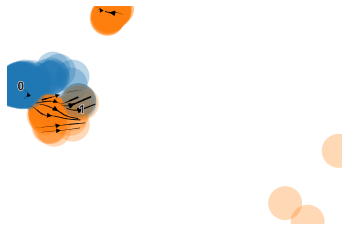

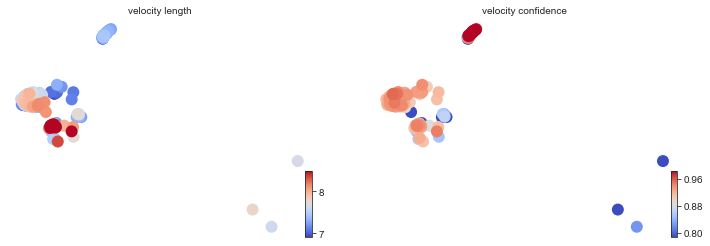

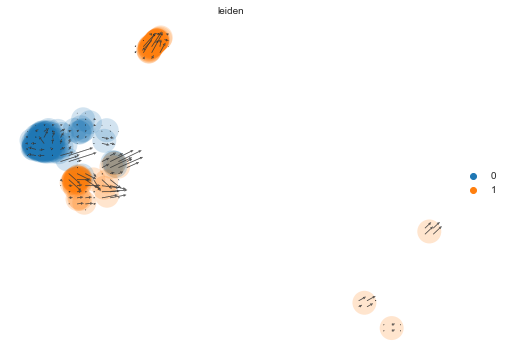

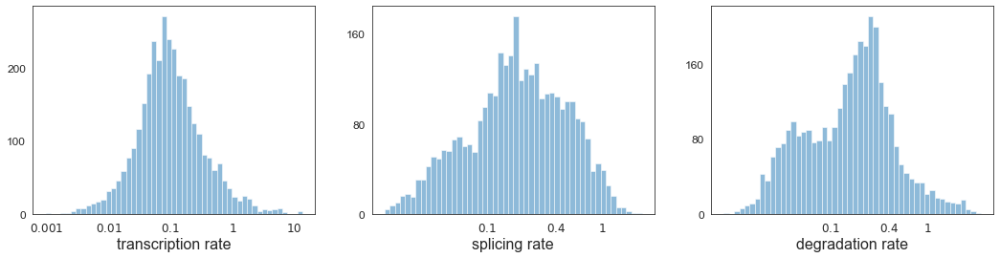

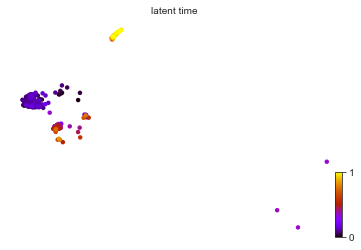

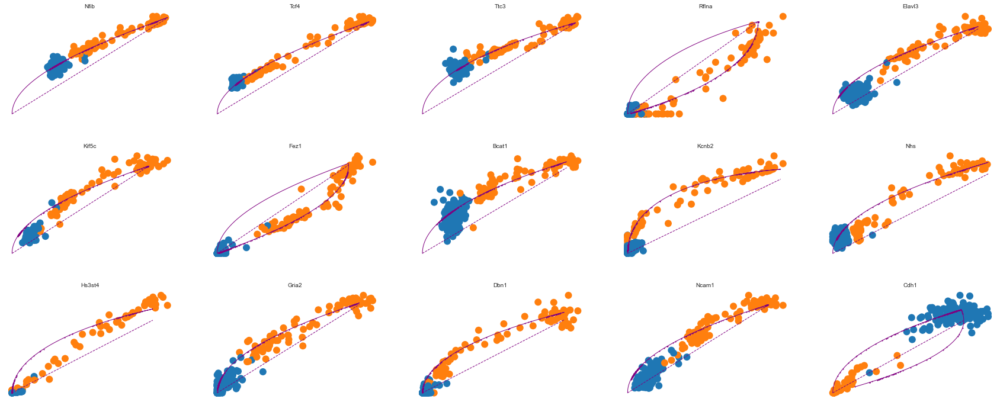

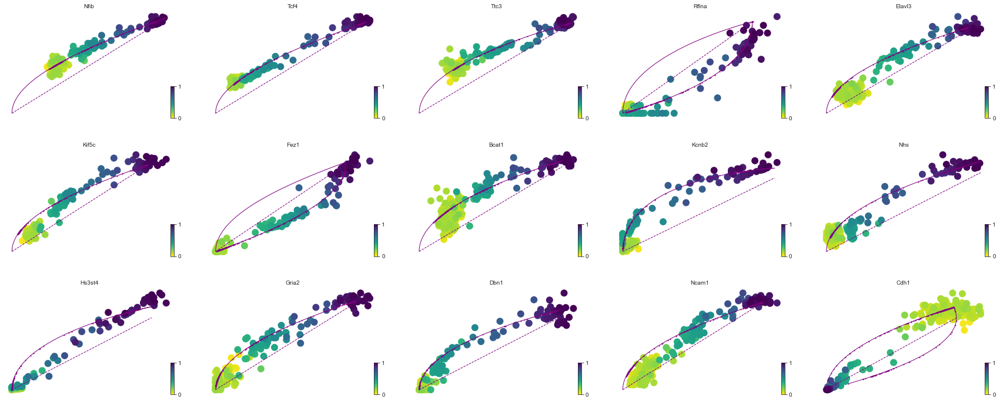

  0%|          | 0/5268 [00:00<?, ?gene/s]

  0%|          | 0/389 [00:00<?, ?cells/s]

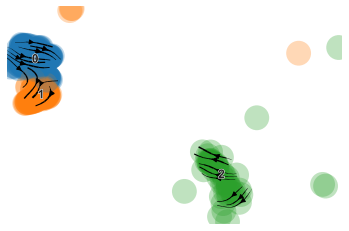

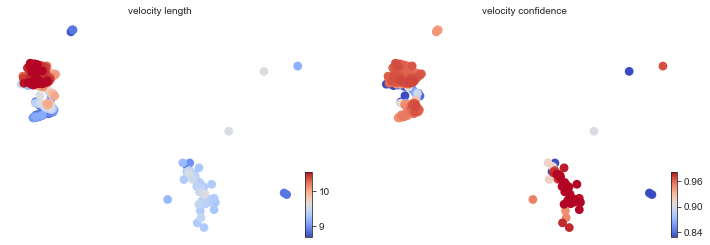

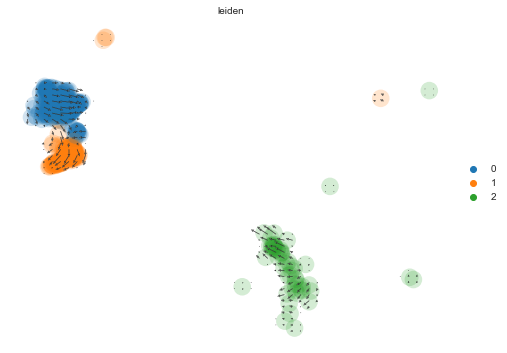

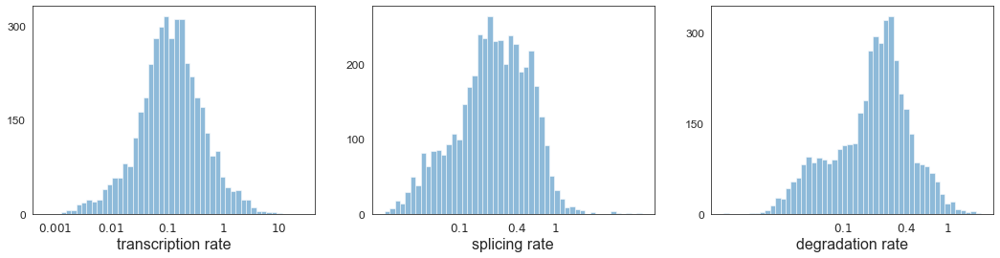

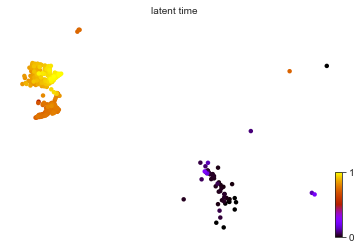

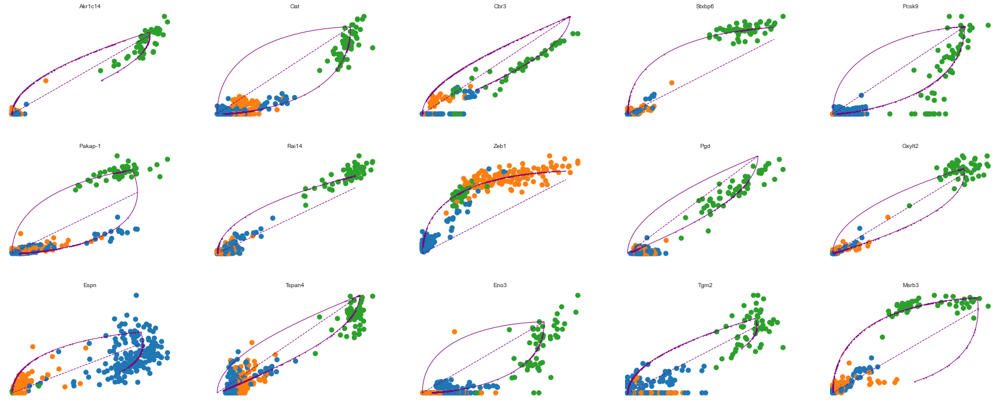

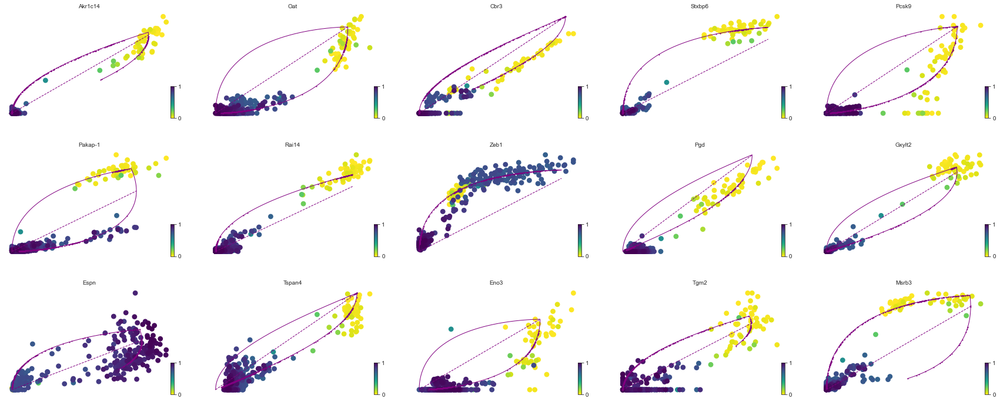

  0%|          | 0/2442 [00:00<?, ?gene/s]

  0%|          | 0/3317 [00:00<?, ?cells/s]

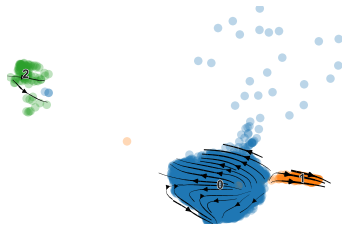

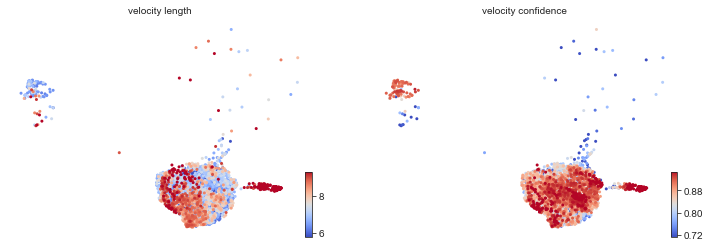

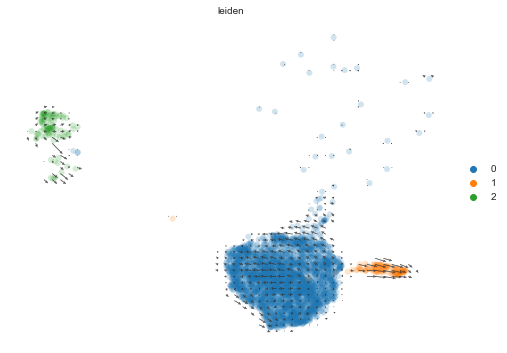

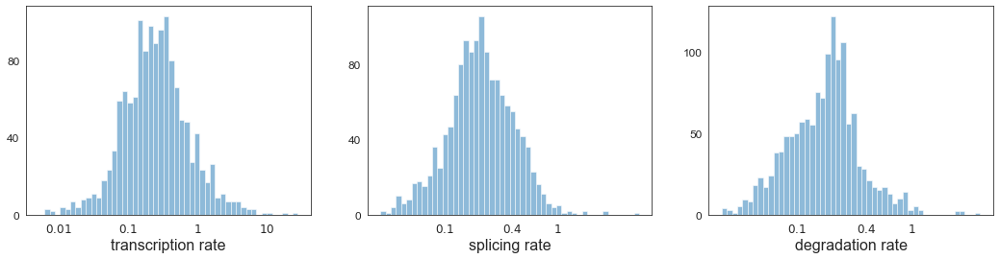

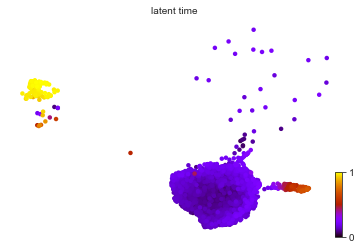

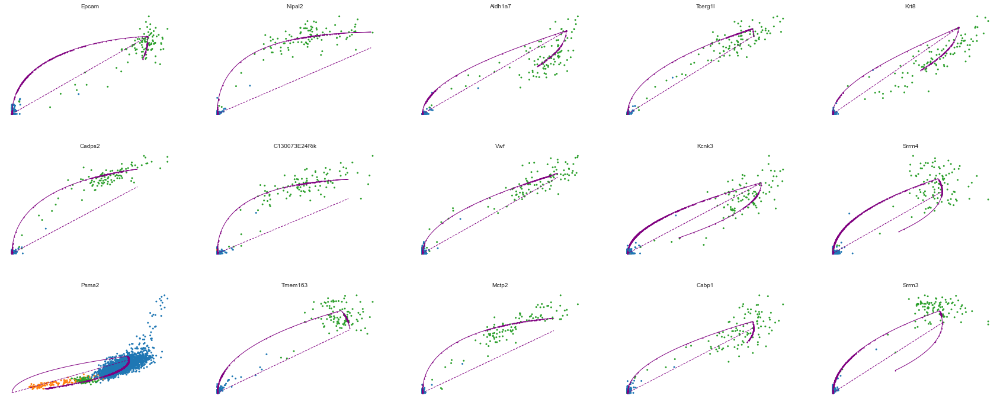

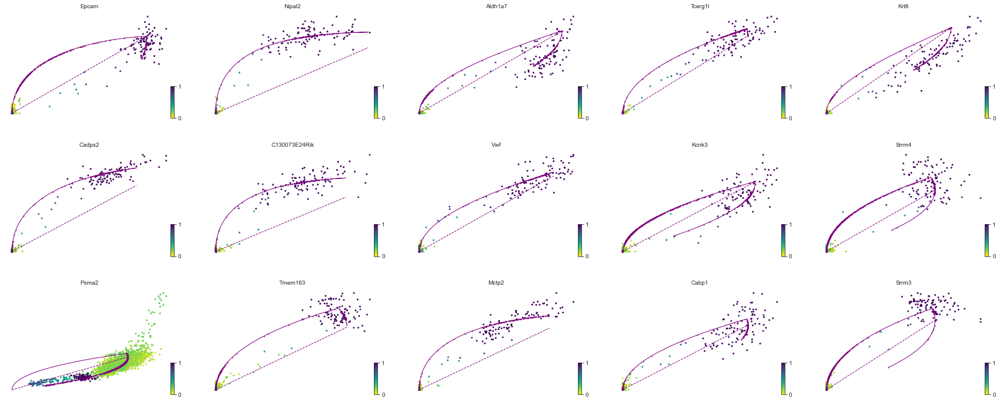

  0%|          | 0/1703 [00:00<?, ?gene/s]

  0%|          | 0/3645 [00:00<?, ?cells/s]

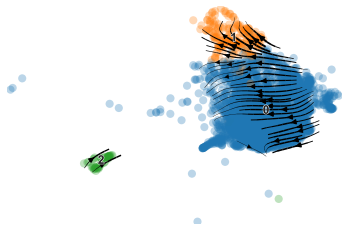

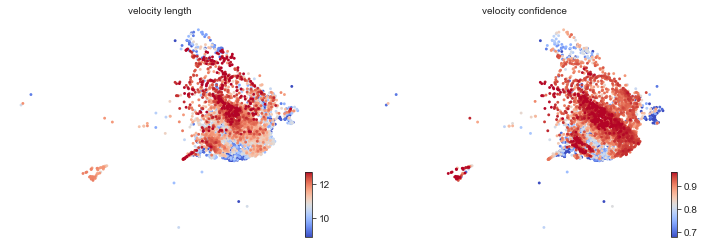

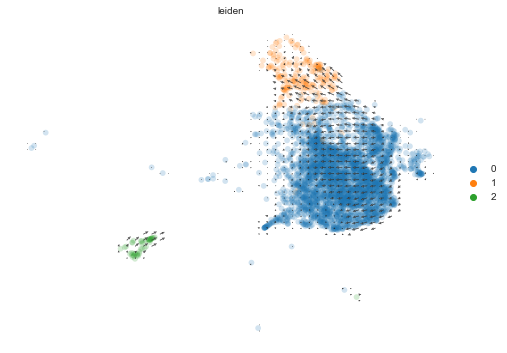

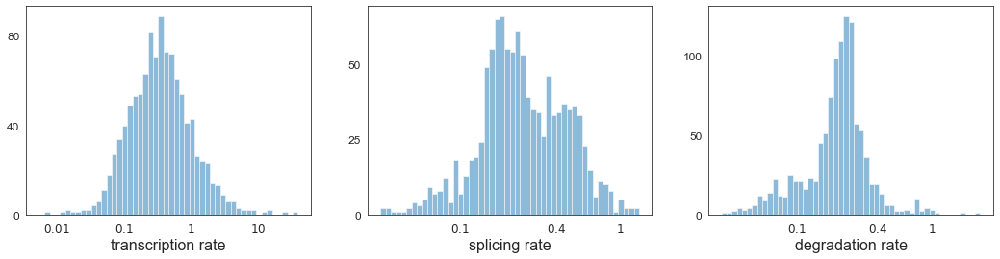

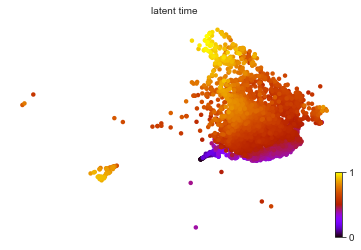

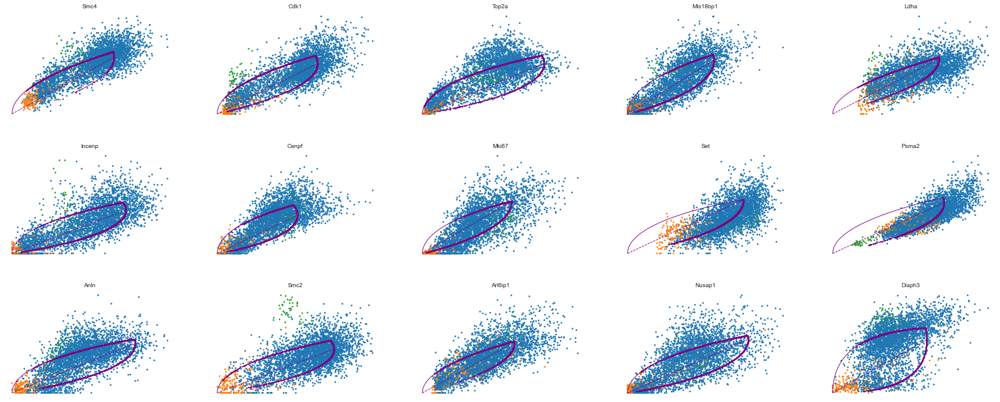

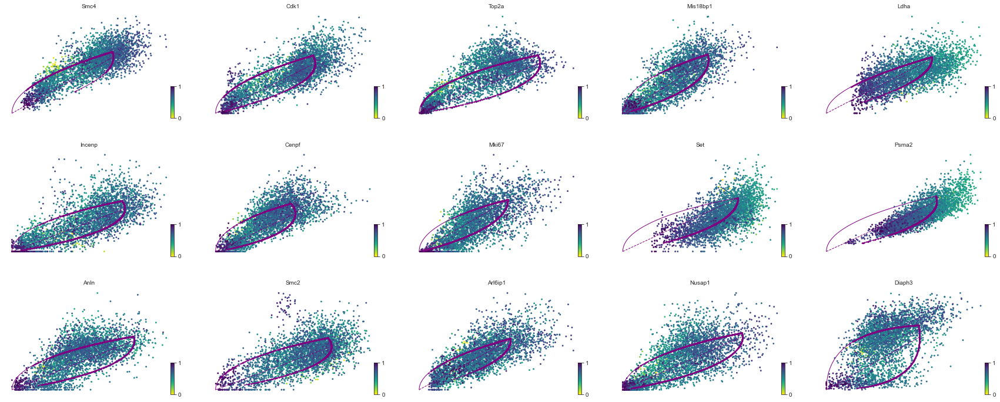

  0%|          | 0/1577 [00:00<?, ?gene/s]

  0%|          | 0/3946 [00:00<?, ?cells/s]

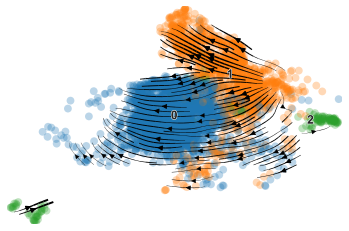

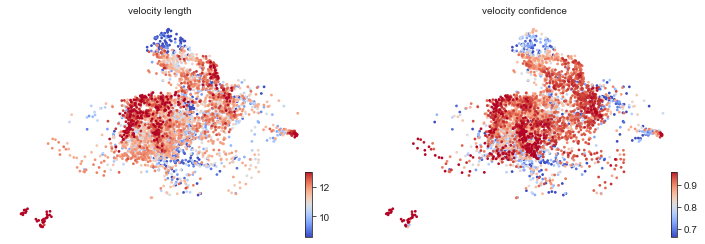

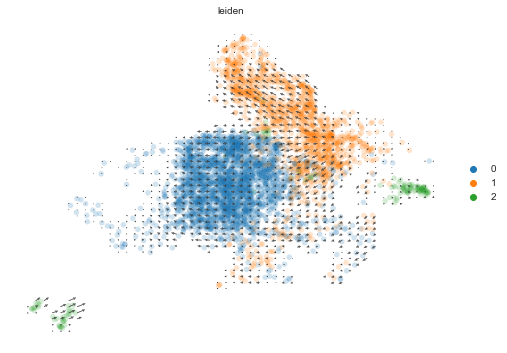

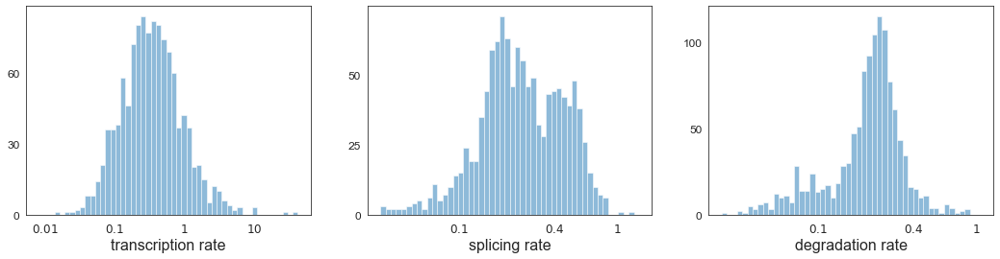

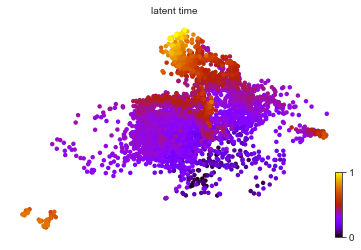

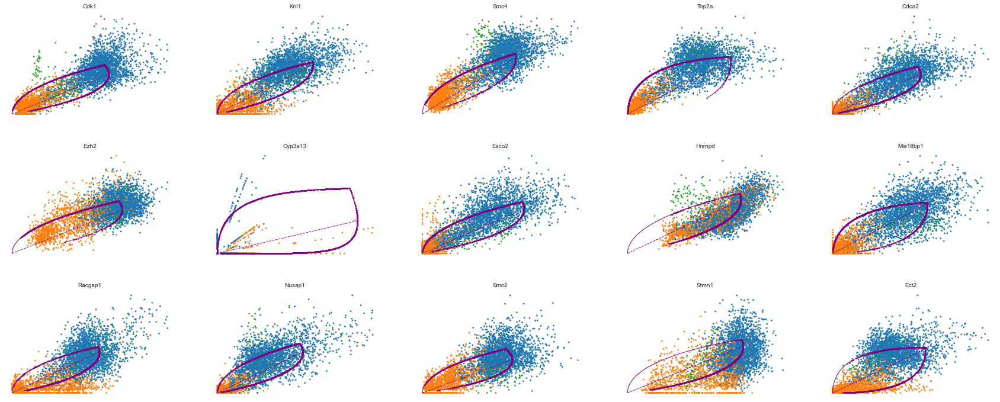

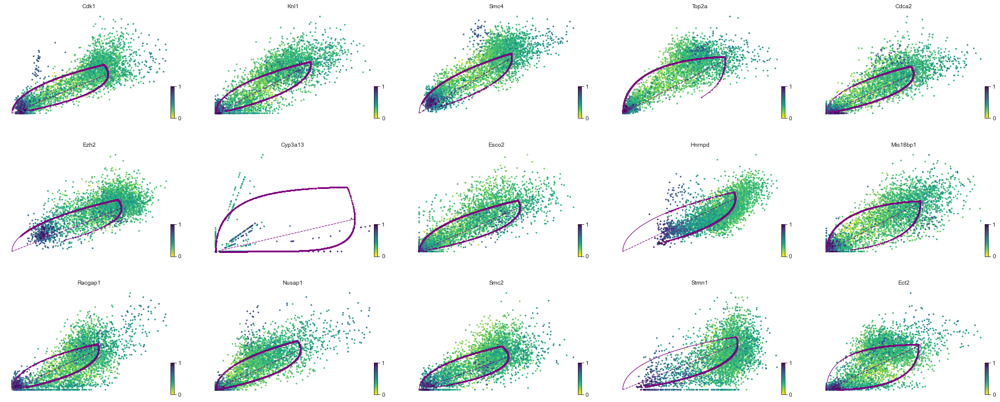

  0%|          | 0/1832 [00:00<?, ?gene/s]

  0%|          | 0/3632 [00:00<?, ?cells/s]

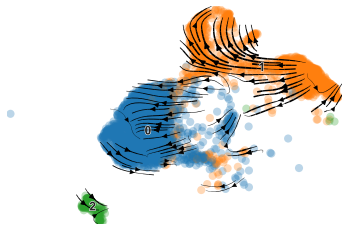

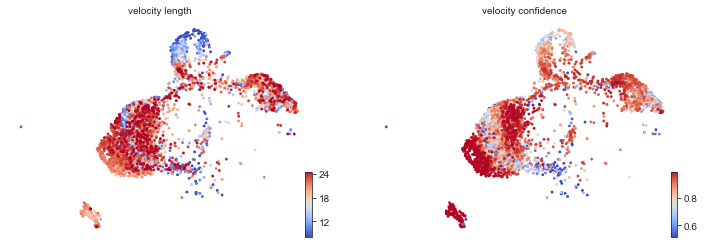

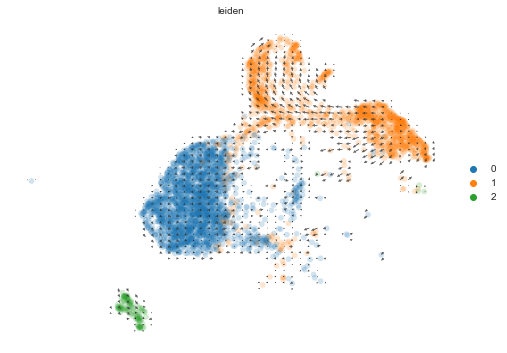

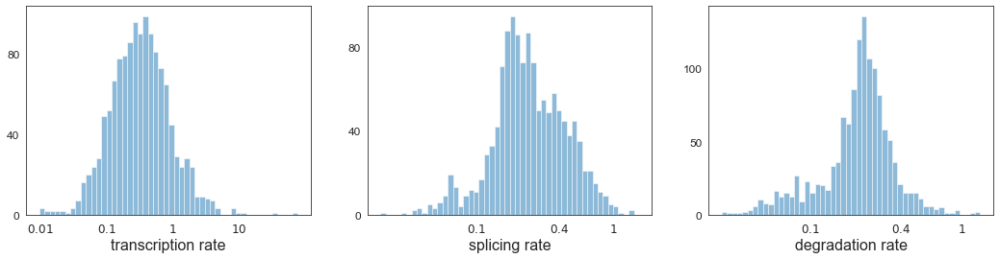

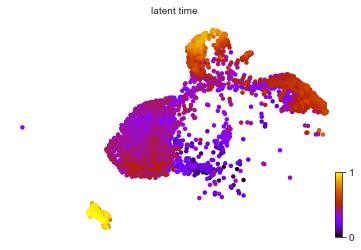

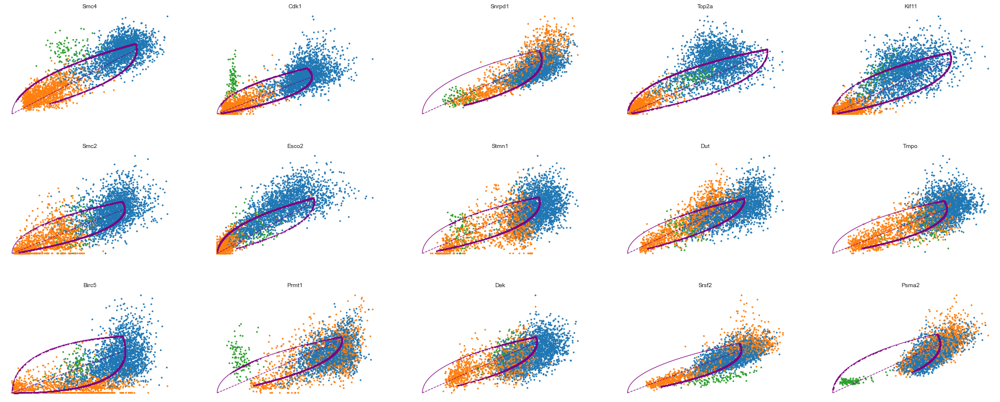

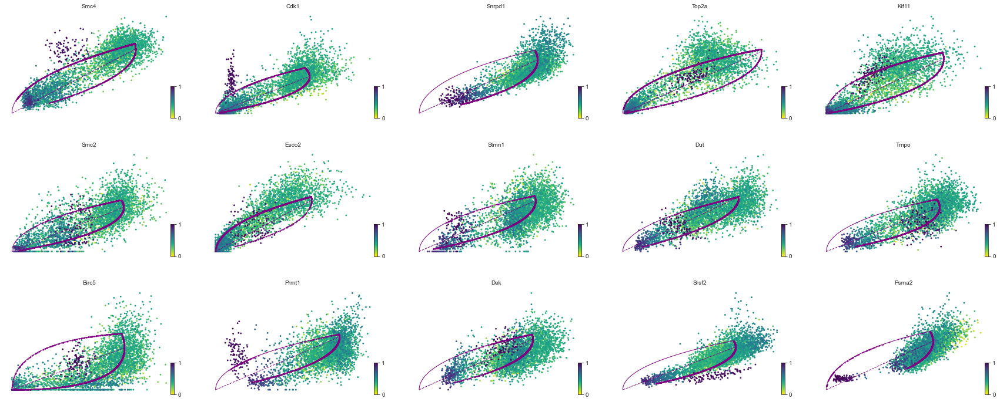

In [123]:
[a4_cr,a7_cr,a11_cr,a14_cr,a17_cr,a21_cr] = [rna_velocity_recipe(a, copy = True, basis = 'umap_imputed', resolution=.2, save=i) for a in [a4,a7,a11,a14,a17,a21]]

### Merge datasets back together

Based on https://cellrank.readthedocs.io/en/stable/auto_examples/kernels/compute_kernel_tricks.html#sphx-glr-auto-examples-kernels-compute-kernel-tricks-py, it seems that to run CellRank we need the attributes:
-  obs: (maybe) 'velocity_self_transition'
-  var:  'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes'
-  uns:  'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
- obsm: 'velocity_umap_imputed'
- varm: 'loss'
- layers: 'Ms', 'Mu', 'fit_t', 'fit_tau', 'fit_tau_', 'velocity', 'velocity_u'


We'll first see if we can just add the velocity layers.

In [140]:
adata_comb = a4_cr.concatenate([a7_cr,a11_cr,a14_cr,a17_cr,a21_cr], batch_key='timepoint', batch_categories=['4','7','11','14','17','21'])

In [143]:
adata_comb.obsp = adata.obsp

In [149]:
adata_comb.uns = adata.uns

In [162]:
scv.tl.velocity_graph(adata_comb)


  0%|          | 0/15138 [00:00<?, ?cells/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: 

In [165]:
adata_comb.obsm

AxisArrays with keys: ParetoTI_S, X_pca, X_pca_imputed, X_umap, X_umap_imputed, velocity_umap_imputed, schur_vectors_fwd, terminal_states_memberships, to_terminal_states

## CellRank

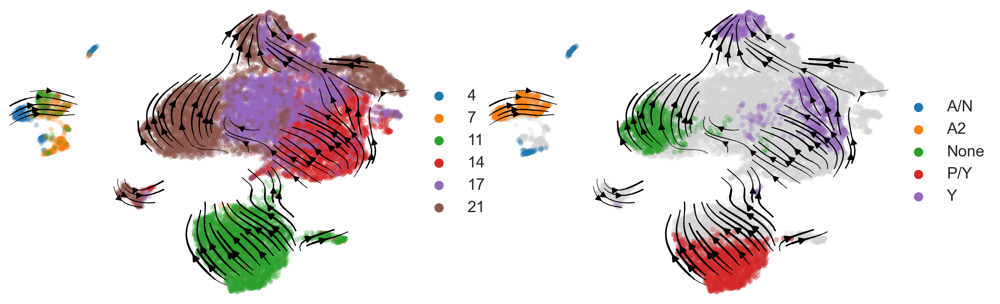

In [183]:
scv.pl.velocity_embedding_stream(
    adata_comb, basis="umap_imputed", color = ['timepoint', 'ParetoTI_specialists'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300,
    #save = 'figures/scvelo_/full-data-diffkinetics/timepoint_arcs_stream.png'
)

In [ ]:
vk = VelocityKernel(adata_comb)
vk.compute_transition_matrix()

  0%|          | 0/15138 [00:00<?, ?cell/s]

  0%|          | 0/15138 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: 

<VelocityKernel>

In [184]:
adata_comb.obsm['X_umap'] = adata_comb.obsm['X_umap_imputed']

In [185]:
combined_kernel = 0.8 * vk + 0.2* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(combined_kernel)
g.compute_schur(n_components=20)
print(g)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000047e+00 -1.8941961938542873e-05 4.9121645230396386e-04 6.7653367706704574e-03 6.1880244111146475e-02 3.2683477444919028e-02 -2.1795789064412485e-02 2.4652399257925978e-02 6.1485592877948095e-02 -6.2440578488640562e-02 -6.1734723739358816e-03 6.6319841212285641e-03 -1.9802187595208777e-02 1.5096728005808231e-02 1.0268420842216585e-02 7.2807296934277906e-03 3.0016754815460352e-02 -1.2714648549374197e-02 -2.7589152196126746e-02 -3.4849666847306844e-02 
0.0000000000000000e+00 9.9945734910192363e-01 1.2426976826583149e-03 -3.4314152378533107e-04 -1.3431388244175328e-02 -6.9133792420346066e-03 4.9897661521251828e-03 -5.4421886298328852e-03 -1.0602160196334878e-02 1.1871777477383841e-02 -2.4413758772668985e-02 -1.2336056691176548e-03 4.6546552145558849e-03 -1.2893638397358906e-03 -1.1041557752944997e-03 -2.7782756903512607e-03 1.1997595385238800e-01 -7.7731721905211729e-02 2.9844789300530819e-03 9.2348992745817128e-03 
0.000000000000

## Macrostates: timepoints

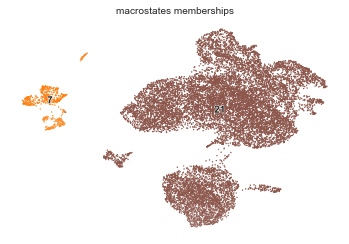

  0%|          | 0/2 [00:00<?, ?/s]

In [186]:
g.compute_macrostates(cluster_key="timepoint") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [187]:
scv.tl.paga(
    adata_comb,
    groups="timepoint",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="Diffusion Pseudotime",
)

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


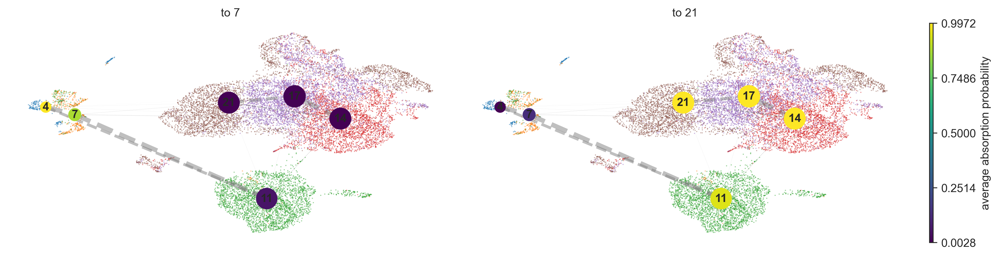

In [188]:
cr.pl.cluster_fates(
    adata_comb,
    mode="paga",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300, save = './figures/scvelo_/by-timepoint/paga_timepoint.png')

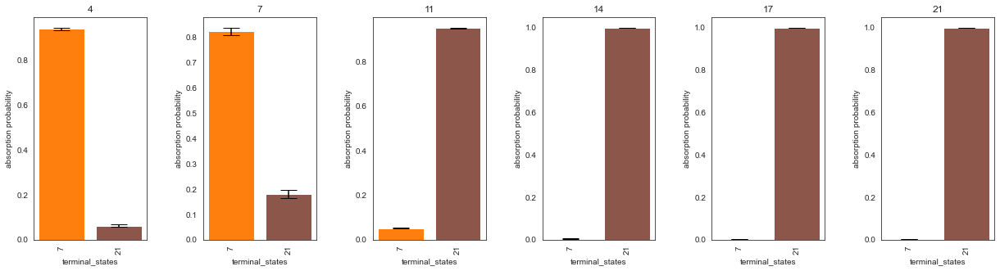

In [168]:
cr.pl.cluster_fates(
    adata_comb,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed", ncols = 6, save = './figures/scvelo_/by-timepoint/paga_bar_timepoint.pdf')


## Macrostates: subtypes

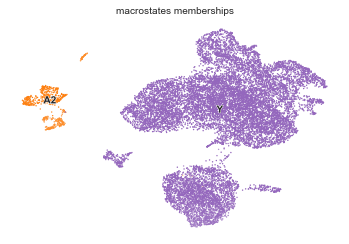

  0%|          | 0/2 [00:00<?, ?/s]

In [189]:
g.compute_macrostates(cluster_key="ParetoTI_specialists") #to change macrostates calcualted by archetype
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

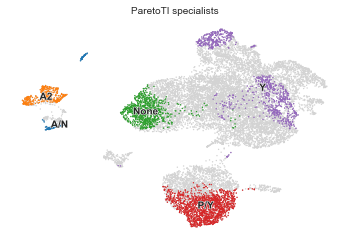

In [190]:
scv.pl.scatter(adata_comb, color = 'ParetoTI_specialists')

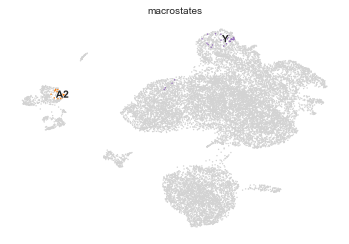

In [191]:
g.plot_macrostates(discrete=True)


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


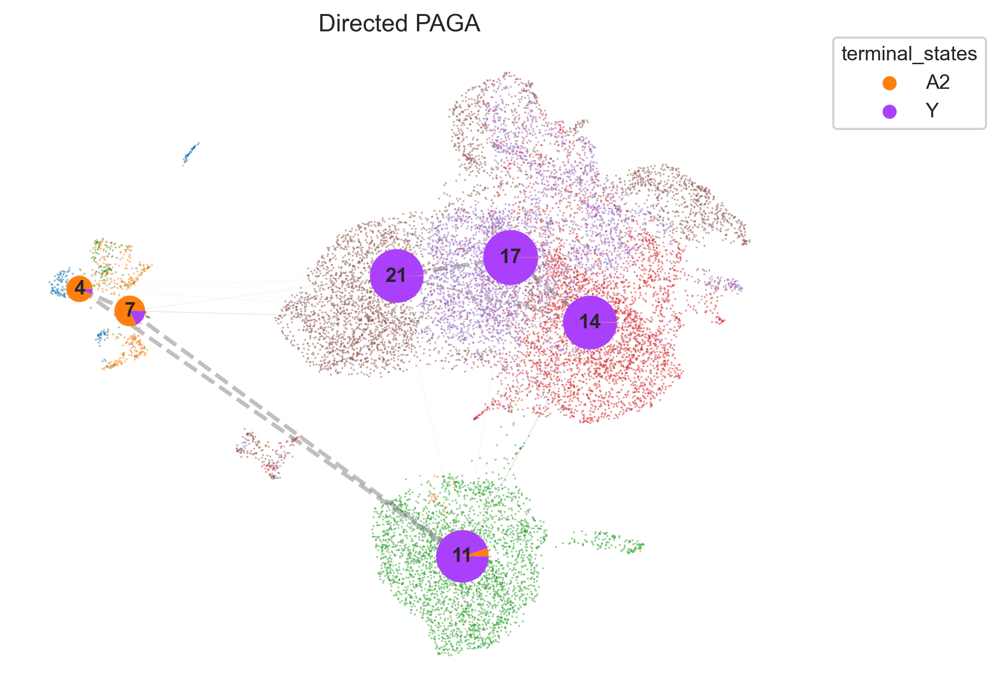

In [170]:
cr.pl.cluster_fates(
    adata_comb,
    mode="paga_pie",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=4,
    edge_width_scale=1,
    min_edge_width=1,
    dpi = 300,
    title="Directed PAGA",figsize = (6, 5), save = './figures/scvelo_/by-timepoint/paga_subtype.png')

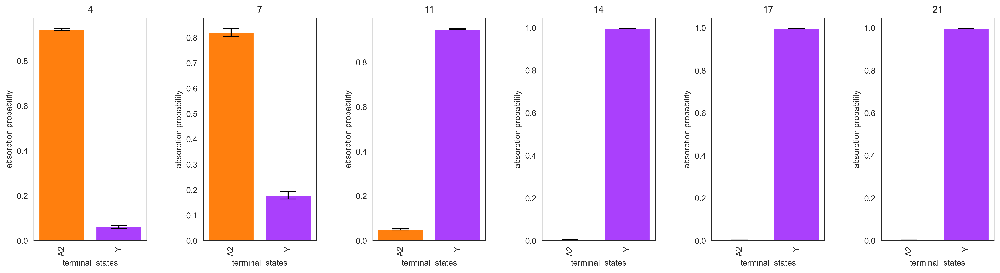

In [171]:
cr.pl.cluster_fates(
    adata_comb,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed",ncols = 6, save = './figures/scvelo_/by-timepoint/paga_bar_subtype.png', dpi = 300)


## Different weights for DPT

In [192]:
combined_kernel = 0.2 * vk + 0.8* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(combined_kernel)
g.compute_schur(n_components=20)
print(g)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000042e+00 4.7354904832813108e-06 1.2280411307250227e-04 -1.6913341926741460e-03 -1.5470061027789120e-02 8.1708693612386699e-03 -5.4489472660950210e-03 6.1630998144924917e-03 -1.5371398219486833e-02 -1.5610144622172003e-02 -1.5433680934686886e-03 -1.6579960302985687e-03 4.9505468988074721e-03 2.5671052105691802e-03 3.7741820014429066e-03 1.8201824233613515e-03 -7.5041887038052582e-03 3.1786621373050498e-03 6.8972880490280140e-03 8.7124167118316238e-03 
0.0000000000000000e+00 9.9986433727548463e-01 -3.1067442066554671e-04 -8.5785380944119016e-05 -3.3578470610109755e-03 1.7283448104924491e-03 -1.2474415380183143e-03 1.3605471574469254e-03 -2.6505400490513800e-03 -2.9679443693137663e-03 6.1034396931692134e-03 -3.0840141727194712e-04 1.1636638036296605e-03 2.7603894381896324e-04 3.2234095992542128e-04 6.9456892258443887e-04 2.9993988463118799e-02 -1.9432930476305621e-02 7.4611973249926800e-04 2.3087248186289626e-03 
0.000000000000000

## Macrostates: timepoints

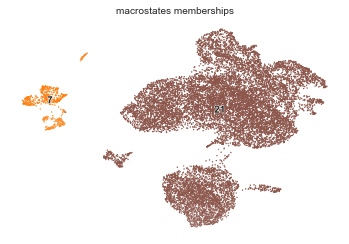

  0%|          | 0/2 [00:00<?, ?/s]

In [193]:
g.compute_macrostates(cluster_key="timepoint") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [194]:
scv.tl.paga(
    adata_comb,
    groups="timepoint",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="Diffusion Pseudotime",
)

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


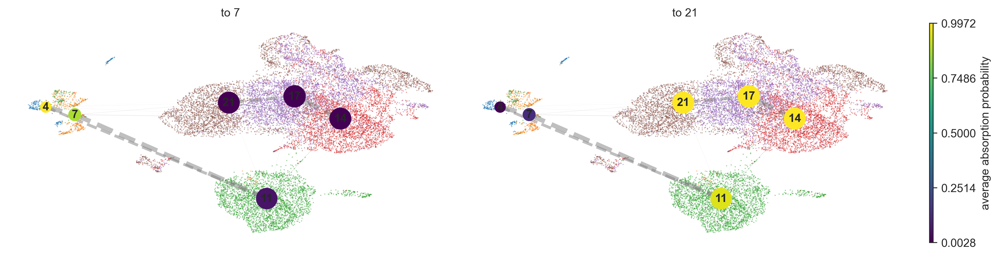

In [195]:
cr.pl.cluster_fates(
    adata_comb,
    mode="paga",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300)#, save = './figures/scvelo_/by-timepoint/paga_timepoint.png')

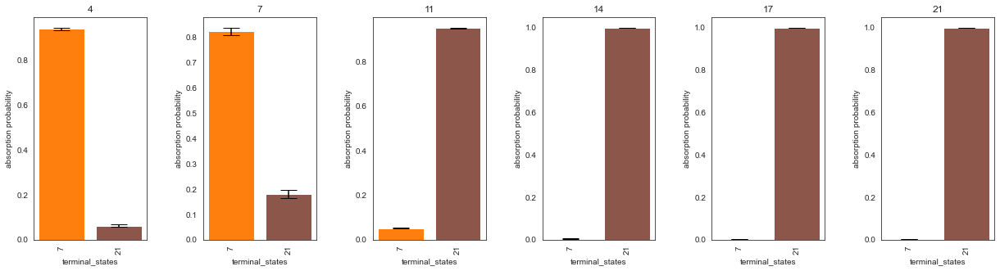

In [168]:
cr.pl.cluster_fates(
    adata_comb,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed", ncols = 6, save = './figures/scvelo_/by-timepoint/paga_bar_timepoint.pdf')


In [197]:
adata_comb.uns['coarse_fwd'] = None #there isn't an implementation to write to h5ad with an anndata object in attributes of another anndata
adata_comb.write_h5ad('../../out/RPM-time-series/adata_04_by-timepoint-merged.h5ad')